### 0. Imports

In [3]:
import warnings

warnings.filterwarnings("ignore")

import os
import re
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
import random
import sc_toolbox
import anndata as ad
import scanpy.external as sce
from scipy import sparse

import preprocessing
import plots

In [108]:
sc.settings.verbosity = 0
sc.set_figure_params(dpi=150, dpi_save=300, frameon=False, format='png')
pd.set_option('display.max_rows', 5000)
plt.rcParams['axes.grid'] = False

In [5]:
!mkdir to_raw_ages_output
output_path='./to_raw_ages_output'

In [72]:
import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
from rpy2.robjects import r

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

In [75]:
%%R
# DEA

.libPaths("/home/student/R/x86_64-pc-linux-gnu-library/4.4")
library(edgeR)

Loading required package: limma


In [174]:
%%R
# functional analysis

library(enrichplot)
library(ggplot2)
library(stringr)
library(gprofiler2)

In [333]:
%%R
sessionInfo()

R version 4.4.0 (2024-04-24)
Platform: x86_64-pc-linux-gnu
Running under: Ubuntu 22.04.4 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.10.0 
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.10.0

locale:
 [1] LC_CTYPE=C.UTF-8       LC_NUMERIC=C           LC_TIME=C.UTF-8       
 [4] LC_COLLATE=C.UTF-8     LC_MONETARY=C.UTF-8    LC_MESSAGES=C.UTF-8   
 [7] LC_PAPER=C.UTF-8       LC_NAME=C              LC_ADDRESS=C          
[10] LC_TELEPHONE=C         LC_MEASUREMENT=C.UTF-8 LC_IDENTIFICATION=C   

time zone: Etc/GMT+3
tzcode source: system (glibc)

attached base packages:
[1] stats4    tools     stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] gprofiler2_0.2.3            DOSE_3.30.1                
 [3] org.Hs.eg.db_3.19.1         AnnotationDbi_1.66.0       
 [5] stringr_1.5.1               ggplot2_3.5.1              
 [7] enrichplot_1.24.0           clusterProfiler_4.12.0     
 [9] Matrix_

### Create adata object

In [4]:
donors = os.listdir('./single_matrices')
donors.extend(os.listdir('./single_matrices/65+'))
young = []
old = []

young_ages = []
old_ages = []

min_young_age = 36
max_old_age = 70

for donor in donors:
    pattern = r'(\d{2})-(?:Male|Female)\.h5ad$'
    match = re.search(pattern, donor)
    if match:
        age = int(match.group(1))
        if age <= 35:
            young.append(donor)
            young_ages.append(age)
        if age >= 70:
            old.append(donor)
            old_ages.append(age)
print(f"{len(young)} young donors from {np.min(young_ages)} to {np.max(young_ages)} years")
print(f"{len(old)} old donors from {np.min(old_ages)} to {np.max(old_ages)} years")

152 young donors from 19 to 35 years
424 old donors from 70 to 97 years


In [5]:
young_adatas = []
for donor in young:
    adata = sc.read_h5ad(os.path.join('./single_matrices', donor))
    young_adatas.append(adata)
adata_young = ad.concat(young_adatas, join='outer')
adata_young.obs['age_group'] = 'Young'

In [6]:
old_adatas = []
old_subset = old
for donor in old_subset:
    adata = sc.read_h5ad(os.path.join('./single_matrices/65+', donor))
    old_adatas.append(adata)
adata_old = ad.concat(old_adatas, join='outer')
adata_old.obs['age_group'] = 'Old'

In [7]:
adata_young

AnnData object with n_obs × n_vars = 478044 × 32852
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'nCount_RNA', 'nFeature_RNA', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age_group'

In [8]:
adata_old

AnnData object with n_obs × n_vars = 538439 × 32852
    obs: 'nCount_RNA', 'nFeature_RNA', 'donor_id', 'pool_number', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age', 'sex', 'dataset', 'ct_cov', 'ethnicity', 'age_group'

In [9]:
adata = ad.concat([adata_young, adata_old], join='outer')

In [10]:
adata

AnnData object with n_obs × n_vars = 1016483 × 32852
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'nCount_RNA', 'nFeature_RNA', 'predicted.celltype.l2', 'predicted.celltype.l2.score', 'age_group'

In [11]:
adata.obs.drop(columns=['nCount_RNA', 'nFeature_RNA', 
                        'predicted.celltype.l2', 'predicted.celltype.l2.score'],
               inplace=True)

In [12]:
# to fix the `TypeError` when writing to .h5ad 
adata.obs['pool_number'] = [str(n) for n in adata.obs['pool_number']]
adata.obs['age'] = [float(n) for n in adata.obs['age']]

In [13]:
adata.write(os.path.join(output_path, 'adata_concatenated_raw.h5ad'))

### Preprocessing

Total number of cells: 1016483
Number of cells after filtering of low quality cells: 941027

Normalizing, logarithming...

Select HVG...


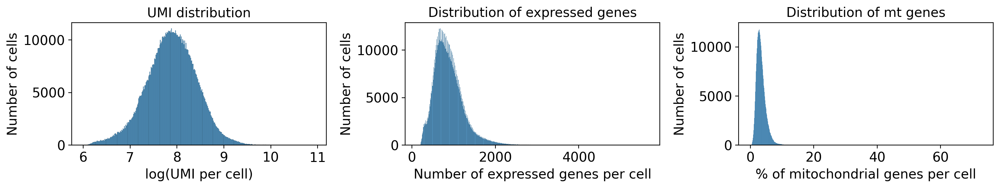

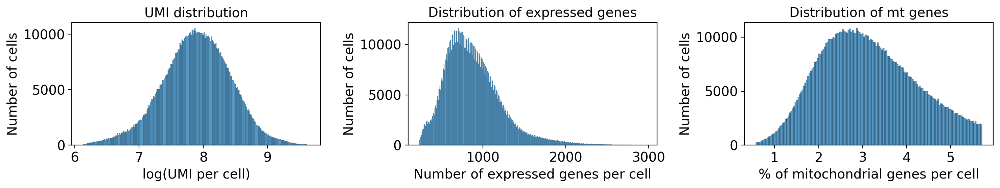

In [14]:
adata = preprocessing.qc_and_preprocess_to_pca(adata, output_dir=output_path)

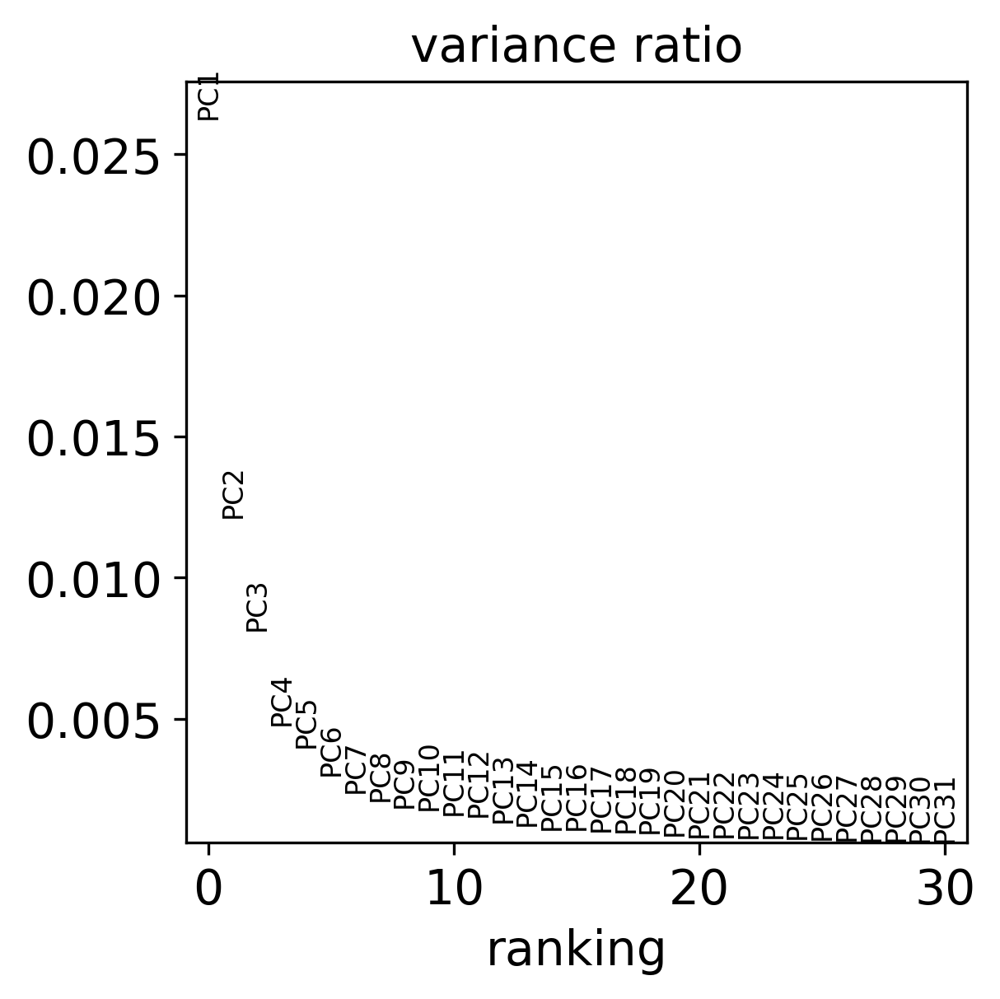

In [15]:
sc.pl.pca_variance_ratio(adata)

In [16]:
adata.write(os.path.join(output_path, 'adata_ages_PCA.h5ad'))

In [2]:
# adata = sc.read_h5ad(os.path.join(output_path, 'adata_ages_PCA.h5ad'))

In [17]:
# BATCH CORRECTION 
sce.pp.harmony_integrate(adata, 'donor_id', max_iter_harmony=20)

2024-05-12 04:24:29,672 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-12 04:24:58,764 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-12 04:25:03,465 - harmonypy - INFO - Iteration 1 of 20
2024-05-12 04:45:14,911 - harmonypy - INFO - Iteration 2 of 20
2024-05-12 05:06:36,023 - harmonypy - INFO - Iteration 3 of 20
2024-05-12 05:28:59,683 - harmonypy - INFO - Iteration 4 of 20
2024-05-12 05:50:43,283 - harmonypy - INFO - Iteration 5 of 20
2024-05-12 06:12:45,718 - harmonypy - INFO - Iteration 6 of 20
2024-05-12 06:33:56,611 - harmonypy - INFO - Iteration 7 of 20
2024-05-12 06:50:06,040 - harmonypy - INFO - Iteration 8 of 20
2024-05-12 07:11:43,731 - harmonypy - INFO - Converged after 8 iterations


In [18]:
adata.write(os.path.join(output_path, 'adata_main_harmony.h5ad'))

In [15]:
%%time
# CLUSTERING
sc.pp.neighbors(
    adata,
    n_pcs=20,
    n_neighbors=30,
    knn=True,
    use_rep="X_pca_harmony",
)

CPU times: user 4min 37s, sys: 5.31 s, total: 4min 42s
Wall time: 4min 32s


In [15]:
%%time
sc.tl.leiden(adata, resolution=0.8, flavor='igraph')
sc.tl.dendrogram(adata, groupby="leiden", n_pcs=20, use_rep="X_pca_harmony", linkage_method="single")

CPU times: user 34.1 s, sys: 1.78 s, total: 35.9 s
Wall time: 35.8 s


In [19]:
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)
sc.tl.umap(adata, init_pos='paga')

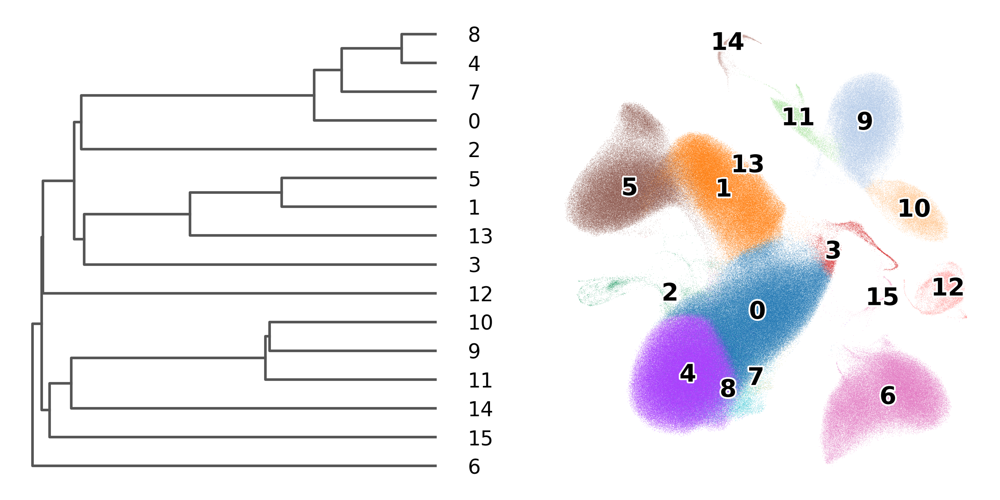

In [9]:
plots.plot_leiden_clusters(adata)

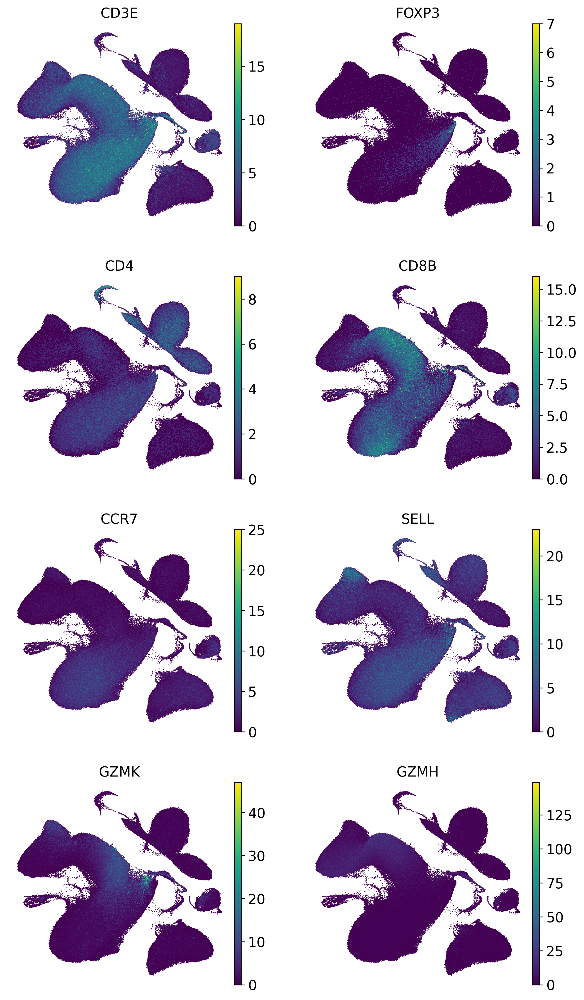

In [8]:
sc.pl.umap(adata, color=['CD3E', 'FOXP3', 'CD4', 'CD8B', 'CCR7', 'SELL', 'GZMK', 'GZMH'], 
           frameon=False, ncols=2, legend_loc="on data", size=3, sort_order=True)

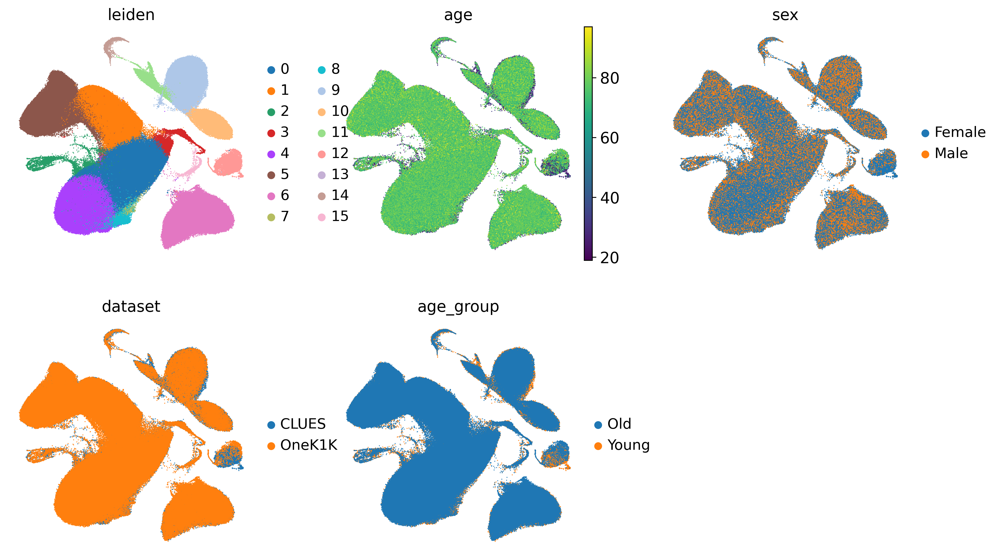

In [7]:
sc.pl.umap(adata, color=['leiden', 'age', 'sex', 'dataset', 'age_group'], 
           frameon=False, ncols=3, size=3, sort_order=False)

### Annotation

In [28]:
import celltypist
from celltypist import models

In [29]:
adata_celltypist = adata.copy()  # make a copy of our adata
adata_celltypist.X = adata.layers["counts"].copy()  # set adata.X to raw counts
sc.pp.normalize_per_cell(adata_celltypist, counts_per_cell_after=10**4)  # normalize to 10,000 counts per cell
sc.pp.log1p(adata_celltypist)  # log-transform
# make .X dense instead of sparse, for compatibility with celltypist:
adata_celltypist.X = adata_celltypist.X.toarray()

In [ ]:
# models.download_models(force_update = True)

In [30]:
model_pbmc = models.Model.load(model="Healthy_COVID19_PBMC.pkl")

In [58]:
model_pbmc.cell_types

array(['ASDC', 'B_exhausted', 'B_immature', 'B_malignant', 'B_naive',
       'B_non-switched_memory', 'B_switched_memory', 'C1_CD16_mono',
       'CD14_mono', 'CD16_mono', 'CD4.CM', 'CD4.EM', 'CD4.IL22',
       'CD4.Naive', 'CD4.Prolif', 'CD4.Tfh', 'CD4.Th1', 'CD4.Th17',
       'CD4.Th2', 'CD8.EM', 'CD8.Naive', 'CD8.Prolif', 'CD8.TE',
       'CD83_CD14_mono', 'DC1', 'DC2', 'DC3', 'DC_prolif', 'HSC_CD38neg',
       'HSC_CD38pos', 'HSC_MK', 'HSC_erythroid', 'HSC_myeloid',
       'HSC_prolif', 'ILC1_3', 'ILC2', 'MAIT', 'Mono_prolif', 'NKT',
       'NK_16hi', 'NK_56hi', 'NK_prolif', 'Plasma_cell_IgA',
       'Plasma_cell_IgG', 'Plasma_cell_IgM', 'Plasmablast', 'Platelets',
       'RBC', 'Treg', 'gdT', 'pDC'], dtype=object)

In [ ]:
%%time
ct_preds = celltypist.annotate(
    adata_celltypist,
    model=model_pbmc,
    majority_voting=True
)

🔬 Input data has 941027 cells and 3000 genes
🔗 Matching reference genes in the model
🧬 1349 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 30


In [ ]:
ct_preds_adata = ct_preds.to_adata()

In [ ]:
adata.obs["ct_annotation"] = ct_preds_adata.obs.loc[adata.obs.index, "majority_voting"]
adata.obs["ct_conf_score"] = ct_preds_adata.obs.loc[adata.obs.index, "conf_score"]

In [ ]:
adata.write(os.path.join(output_path, 'adata_main_annotated.h5ad'))

In [38]:
adata.obs['ct_annotation'].value_counts()

CD4.Naive            262338
CD4.IL22             156309
NK_16hi              130115
B_naive               96851
CD8.EM                71657
CD83_CD14_mono        57587
CD8.TE                51671
CD8.Naive             42726
CD16_mono             20925
DC3                   11525
MAIT                   9246
NK_56hi                7856
B_switched_memory      5295
pDC                    3681
NK_prolif              3179
Platelets              2681
CD4.CM                 2219
B_exhausted            2082
Plasma_cell_IgA        1822
HSC_CD38pos             801
C1_CD16_mono            461
Name: ct_annotation, dtype: int64

### Manual anno validation

In [6]:
adata = sc.read_h5ad(os.path.join(output_path, 'adata_main_annotated.h5ad'))

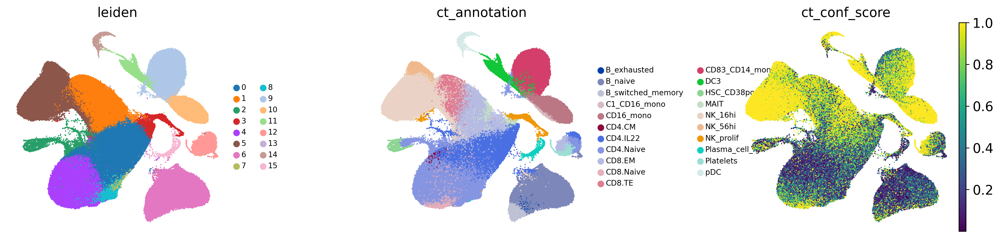

In [5]:
sc.pl.umap(
    adata,
    color=['leiden', "ct_annotation", "ct_conf_score"],
    frameon=False,
    sort_order=False,
    wspace=0.5,
    size=7,
    legend_fontsize=8
)

In [6]:
sc.tl.leiden(adata, restrict_to=('leiden', ['4']), resolution=0.3, flavor='igraph')

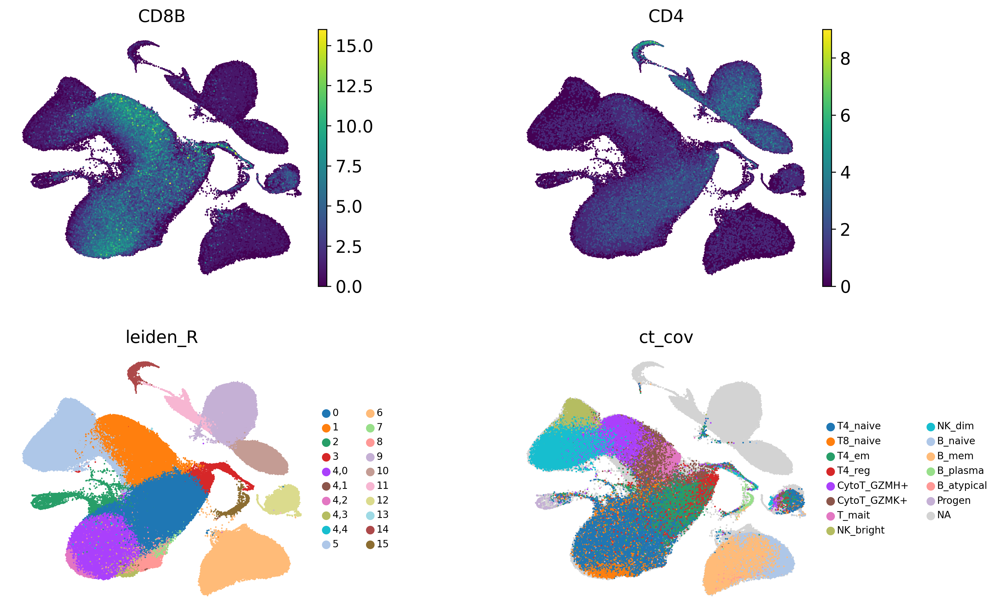

In [41]:
sc.pl.umap(
    adata,
    color=['CD8B', 'CD4', 'leiden_R', "ct_cov"],
    frameon=False,
    sort_order=True,
    wspace=0.5,
    size=7,
    legend_fontsize=8,
    ncols=2
)

In [21]:
(adata.obs['ct_annotation'] == 'CD8.Naive').sum()

42726

In [24]:
(adata.obs['ct_cov'] == 'T8_naive').sum()

26268

In [30]:
(adata.obs['ct_annotation'] == 'CD8.Naive').sum()

41272

In [52]:
(adata.obs['dataset'] == 'OneK1K').sum()

603003

In [53]:
(adata.obs['dataset'] == 'CLUES').sum()

338024

### CD8 cell types and Treg selection

> Retain the celltypist annotation categories because, with a large number of cells from elderly donors, the low content of naive CD8 T cells seems plausible

In [7]:
adata_cd8 = adata[[type in ('CD8.Naive', 'CD8.EM', 'CD8.TE') for type in adata.obs['ct_annotation']]]

In [8]:
adata_cd8.shape

(166054, 3000)

In [9]:
(adata_cd8.X.T[adata_cd8.var_names == 'CD4'] > 0).sum()

6279

In [10]:
# drop CD4+ cells:
adata_cd8 = adata_cd8[adata_cd8.X.T[adata_cd8.var_names == 'CD4'] < 0]

#### Re-preprocessing

In [11]:
# return raw counts
adata_cd8.X = adata_cd8.layers['counts'].A.copy()

In [12]:
sc.pp.normalize_total(adata_cd8)
sc.pp.log1p(adata_cd8)

sc.pp.scale(adata_cd8)
sc.tl.pca(adata_cd8)

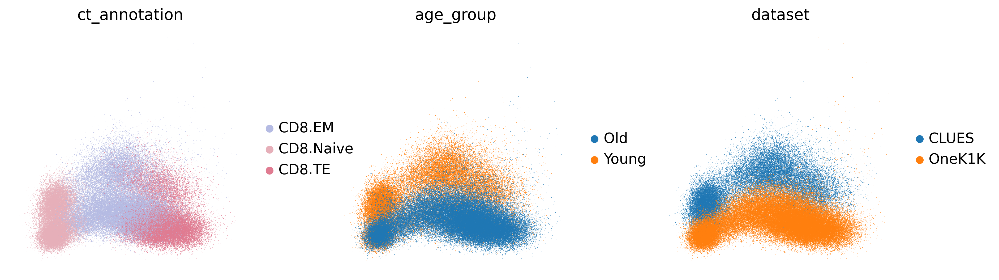

In [13]:
sc.pl.pca_scatter(adata_cd8, color=['ct_annotation', 'age_group', 'dataset'])

In [14]:
# 3. BATCH CORRECTION
sce.pp.harmony_integrate(adata_cd8, key='donor_id', max_iter_harmony=20)

2024-06-06 16:38:22,446 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-06-06 16:38:29,409 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-06-06 16:38:30,402 - harmonypy - INFO - Iteration 1 of 20
2024-06-06 16:42:32,180 - harmonypy - INFO - Iteration 2 of 20
2024-06-06 16:46:34,334 - harmonypy - INFO - Iteration 3 of 20
2024-06-06 16:50:38,219 - harmonypy - INFO - Iteration 4 of 20
2024-06-06 16:54:40,441 - harmonypy - INFO - Iteration 5 of 20
2024-06-06 16:58:11,086 - harmonypy - INFO - Iteration 6 of 20
2024-06-06 17:01:25,210 - harmonypy - INFO - Iteration 7 of 20
2024-06-06 17:05:23,316 - harmonypy - INFO - Iteration 8 of 20
2024-06-06 17:08:44,164 - harmonypy - INFO - Iteration 9 of 20
2024-06-06 17:11:53,272 - harmonypy - INFO - Iteration 10 of 20
2024-06-06 17:15:01,928 - harmonypy - INFO - Iteration 11 of 20
2024-06-06 17:18:10,162 - harmonypy - INFO - Iteration 12 of 20
2024-06-06 17:21:14,336 - harmonypy - INFO - Converged after

In [16]:
sc.pp.neighbors(
    adata_cd8,
    n_pcs=15,
    n_neighbors=15,
    knn=True,
    use_rep="X_pca_harmony"
)

In [17]:
sc.tl.leiden(adata_cd8, resolution=0.4, flavor='igraph', key_added='leiden_cd8')

In [18]:
sc.tl.paga(adata_cd8)
sc.pl.paga(adata_cd8, plot=False)
sc.tl.umap(adata_cd8, init_pos='paga')

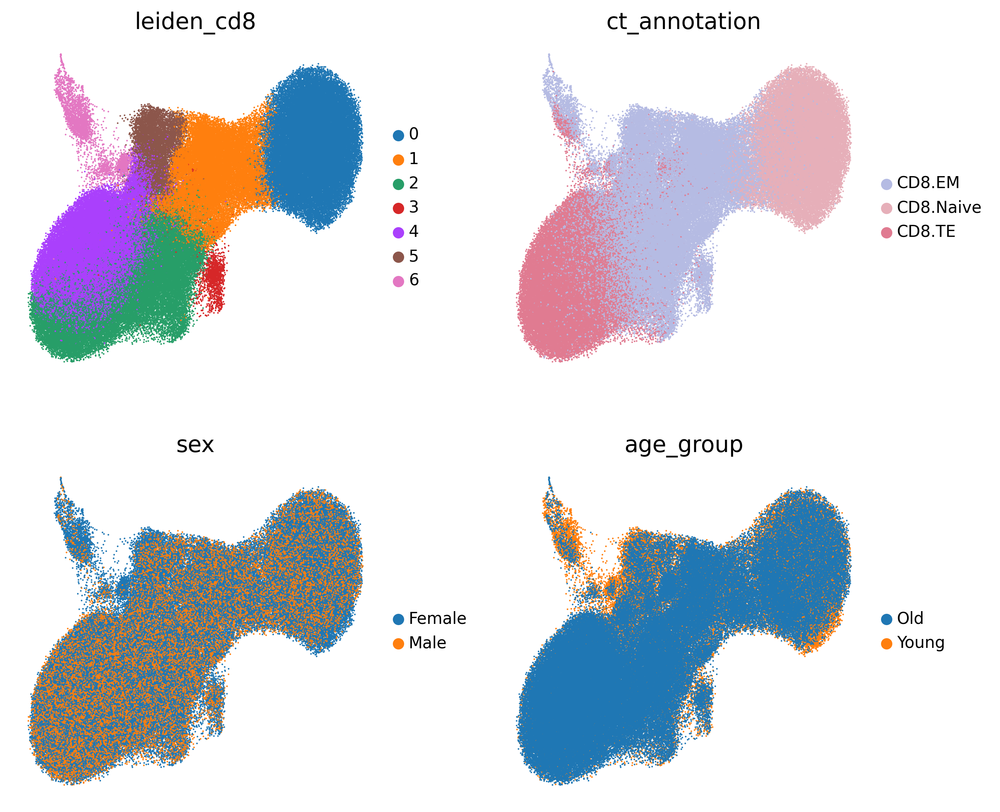

In [19]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'ct_annotation', 'sex', 'age_group'], 
           frameon=False, size=4, ncols=2,
           legend_fontsize=10, sort_order=False
          ) 

In [28]:
adata_cd8 = adata_cd8[adata_cd8.obs['leiden_cd8'] != '6']

In [30]:
adata_cd8.write(os.path.join(output_path, 'adata_cd8_leiden.h5ad'))

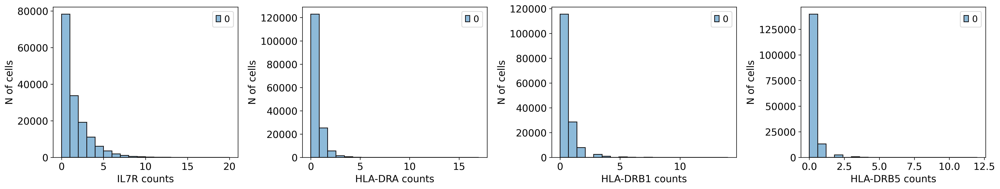

In [31]:
fig, axs = plt.subplots(ncols=4, figsize=(20, 4))

for n, gene in enumerate(['IL7R', 'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5']):
    gene_counts = adata_cd8[:, gene].layers['counts'].A
    sns.histplot(gene_counts, bins=20, ax=axs[n])
    axs[n].set_xlabel(f'{gene} counts')
    axs[n].set_ylabel('N of cells')
plt.tight_layout() 

In [32]:
filtered = adata_cd8[(np.greater(adata_cd8[:, 'HLA-DRA'].layers['counts'].A, 1) 
                      | np.greater(adata_cd8[:, 'HLA-DRB1'].layers['counts'].A, 1)
                      | np.greater(adata_cd8[:, 'HLA-DRB5'].layers['counts'].A, 1))
                    & np.less_equal(adata_cd8[:, 'IL7R'].layers['counts'].A, 0)]
adata_cd8.obs['is_CD8Treg'] = [name in list(filtered.obs_names) for name in adata_cd8.obs_names]
print(adata_cd8.obs['is_CD8Treg'].sum())
print(f"{adata_cd8.obs['is_CD8Treg'].sum() / adata_cd8.obs['is_CD8Treg'].size * 100:.2f}%")

10633
6.80%


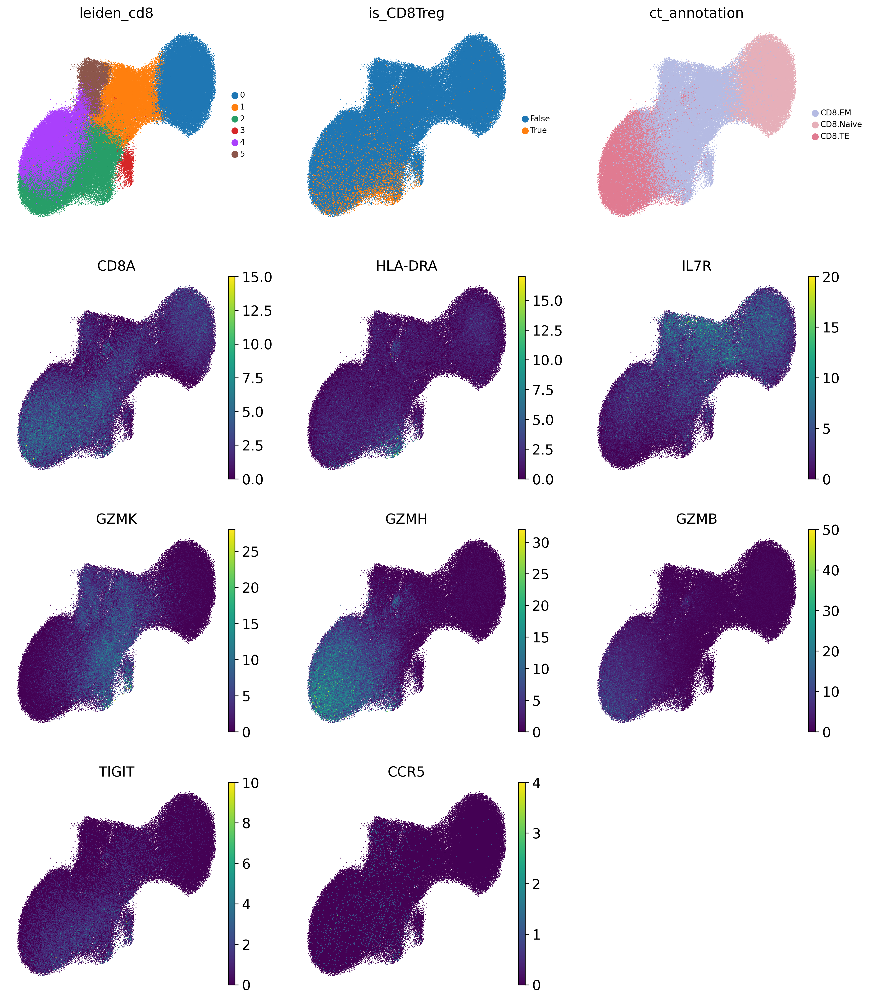

In [33]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'is_CD8Treg', 'ct_annotation', 
                             'CD8A', 'HLA-DRA', 'IL7R', 'GZMK', 'GZMH', 'GZMB', 'TIGIT', 'CCR5'], 
           frameon=False, 
           size=4, 
           ncols=3,
           legend_fontsize=8,         
           sort_order=True
          ) 

In [46]:
adata_cd8.uns['leiden_cd8_colors'] = ['#93e8a7', '#FFD57A', '#A2CF1A', '#A6E1FA', '#FF8CA7', '#61488A']
adata_cd8.uns['is_CD8Treg_colors'] = ['#dfecf5', '#f022ca']

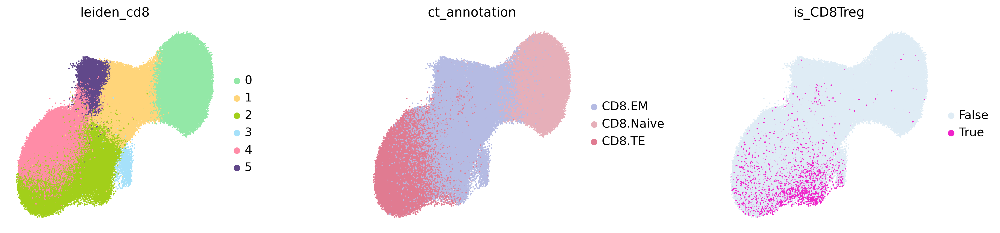

In [51]:
sc.pl.umap(adata_cd8, color=['leiden_cd8', 'ct_annotation', 'is_CD8Treg'], 
           size=10, wspace=0.5, sort_order=True)

In [52]:
adata_cd8.obs.value_counts(subset=['ct_annotation', 'is_CD8Treg']) 
# Treg in CD8.EM 6.4%, in CD8.TE 12.3%, in Naive 1%

ct_annotation  is_CD8Treg
CD8.EM         False         62057
CD8.TE         False         42792
CD8.Naive      False         40802
CD8.TE         True           5979
CD8.EM         True           4245
CD8.Naive      True            409
dtype: int64

In [53]:
# IN AGES:
adata_cd8.obs.value_counts(subset=['age_group', 'ct_annotation', 'is_CD8Treg'], sort=False) 
# old: Treg in CD8.EM 7.6%, in CD8.TE 12.7%, in Naive 0.3%
# young: Treg in CD8.EM 4.3%, in CD8.TE 11%, in Naive 1.4%

age_group  ct_annotation  is_CD8Treg
Old        CD8.EM         False         39770
                          True           3250
           CD8.Naive      False         14937
                          True             49
           CD8.TE         False         31033
                          True           4526
Young      CD8.EM         False         22287
                          True            995
           CD8.Naive      False         25865
                          True            360
           CD8.TE         False         11759
                          True           1453
dtype: int64

In [54]:
adata_cd8.obs.value_counts(subset=['age_group', 'is_CD8Treg'], sort=False) 

age_group  is_CD8Treg
Old        False         85740
           True           7825
Young      False         59911
           True           2808
dtype: int64

In [55]:
adata_cd8.obs['dea_labels'] = adata_cd8.obs['ct_annotation'].astype('object')
adata_cd8.obs['dea_labels'][(adata_cd8.obs['is_CD8Treg'] == True) & (adata_cd8.obs['ct_annotation'] != 'CD8.Naive')] = 'CD8.Treg'
adata_cd8.obs['dea_labels'] = adata_cd8.obs['dea_labels'].astype('category')

In [56]:
adata_cd8.write(os.path.join(output_path, 'adata_cd8_dea_labels.h5ad'))

### sc DEA

In [83]:
adata_cd8 = sc.read_h5ad(os.path.join(output_path, 'adata_cd8_dea_labels.h5ad'))

In [58]:
tregs = adata_cd8[adata_cd8.obs['dea_labels'] == 'CD8.Treg']

In [60]:
tregs.shape

(10224, 3000)

In [61]:
tregs_raw = tregs.raw.to_adata()
tregs_raw

AnnData object with n_obs × n_vars = 10224 × 23386
    obs: 'pool_number', 'donor_id', 'ct_cov', 'age', 'sex', 'ethnicity', 'dataset', 'age_group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'outlier', 'mt_outlier', 'n_genes', 'leiden', 'ct_annotation', 'ct_conf_score', 'leiden_cd8', 'is_CD8Treg', 'dea_labels'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'age_group_colors', 'ct_annotation_colors', 'dataset_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'leiden_sizes', 'log1p', 'neighbors', 'paga', 'pca', 'sex_colors', 'umap', 'leiden_cd8', 'leiden_cd8_colors', 'is_CD8Treg_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    obsp: 'connectivities', 'distances'

In [62]:
tregs_raw.layers['counts'] = tregs_raw.X.copy()

In [63]:
sc.pp.log1p(tregs_raw)

In [64]:
sc.tl.rank_genes_groups(tregs_raw, 
                        groupby='age_group',
                        method='wilcoxon',
                        pts=True,
                        use_raw=False
                       )

In [66]:
df = sc.get.rank_genes_groups_df(tregs_raw, group='Old', pval_cutoff=0.05)

In [67]:
df = df[~df.names.str.startswith('RP')]
df = df[df.pct_nz_group > 0.01]
df = df[df.pvals_adj < 0.01]
df.sort_values(by='logfoldchanges', ascending=False, inplace=True)
df.to_csv(os.path.join(output_path, 'sc_dea.csv'))

In [70]:
df.head(50)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
110,DONSON,18.982899,3.889239,2.361954e-80,4.761781e-78,0.283436,0.034722
0,UQCR11.1,40.392536,2.578522,0.000000e+00,0.000000e+00,0.694316,0.154820
40,NDUFB8.1,27.279684,2.496472,7.389968e-164,4.019111e-161,0.459748,0.093546
737,CLN3.1,5.397177,2.386417,6.769763e-08,2.061428e-06,0.090149,0.017974
160,TMBIM4.1,15.413890,2.332182,1.320205e-53,1.848761e-51,0.262346,0.055556
461,TAP2.1,7.540720,2.186220,4.673838e-14,2.258314e-12,0.130401,0.029412
310,IER3IP1.1,9.875939,2.089595,5.293439e-23,3.820752e-21,0.176698,0.044935
225,PSMA2.1,12.149302,2.037209,5.785716e-34,5.733252e-32,0.218493,0.055556
1213,NDUFA7.1,3.489976,2.023516,4.830635e-04,8.888216e-03,0.061085,0.014297
1057,BDH1,3.963733,1.956761,7.378683e-05,1.555977e-03,0.073302,0.020425


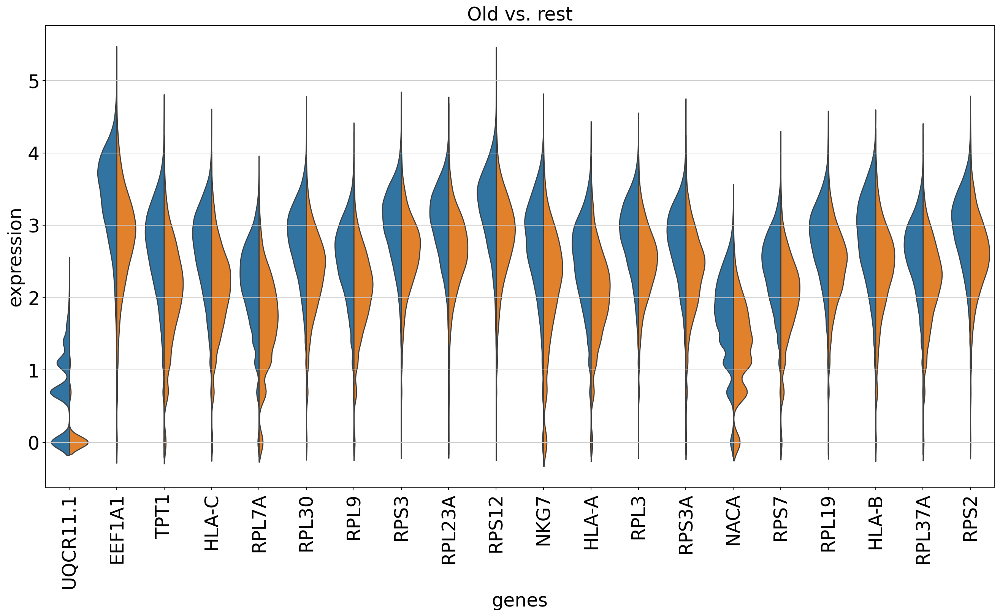

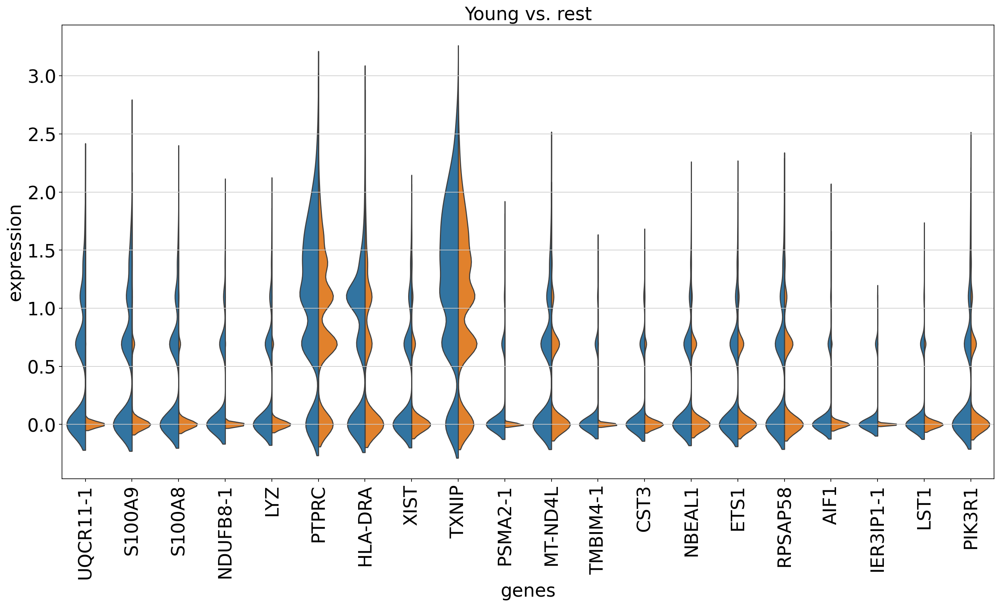

In [71]:
sc.set_figure_params(figsize=(20, 10), fontsize=22)

sc.pl.rank_genes_groups_violin(tregs_raw, jitter=False, size=0, 
                               # groups=['CD8.Treg'], 
                               strip=False,
                               use_raw=False,
                              )

### pseudobulk DEA

In [76]:
tregs = adata_cd8[adata_cd8.obs['dea_labels'] == 'CD8.Treg']

In [78]:
tregs.obs["bulk_sample"] = [
    f"{pool}_{age}" for pool, age in zip(tregs.obs["pool_number"], tregs.obs["age_group"])
]

In [79]:
tregs.obs["bulk_sample"] = tregs.obs["bulk_sample"].astype('category')
tregs.obs["pool_number"] = tregs.obs["pool_number"].astype('category')

In [205]:
def aggregate_and_filter(
    adata,
    # cell_identity,
    donor_key="bulk_sample",
    condition_key="age_group",
    # cell_identity_key="cell_type",
    obs_to_keep=[],  # which additional metadata to keep, e.g. gender, age, etc.
    replicates_per_patient=1,
    min_cells_per_donor=30
):
    """
    Creates an AnnData object with one pseudo-replicate for each donor for a specified 
    subpopulation from the original single-cell AnnData object. 
    Also it filters out donors that have fewer than `min_cells_per_donor' cells 
    for the specified population.

    By changing the `replicates_per_patient` parameter, 
    several (n) pseudo-replicates can be created for each sample; 
    cells are then split into n subsets of roughly equal sizes.
    """
    # subset adata to the given cell identity
    # adata_cell_pop = adata[adata.obs[cell_identity_key] == cell_identity].copy()
    adata_cell_pop = adata
    
    # check which donors to keep according to the number of cells specified with NUM_OF_CELL_PER_DONOR
    size_by_donor = adata_cell_pop.obs.groupby([donor_key]).size()
    donors_to_drop = [
        donor
        for donor in size_by_donor.index
        if size_by_donor[donor] <= min_cells_per_donor
    ]
    if len(donors_to_drop) > 0:
        print("Dropping the following samples:")
        print(donors_to_drop)
    df = pd.DataFrame(columns=[*adata_cell_pop.var_names, *obs_to_keep])

    adata_cell_pop.obs[donor_key] = adata_cell_pop.obs[donor_key].astype("category")
    
    for i, donor in enumerate(donors := adata_cell_pop.obs[donor_key].cat.categories):
        print(f"\tProcessing donor {i+1} out of {len(donors)}...", end="\r")
        
        if donor not in donors_to_drop:
            adata_donor = adata_cell_pop[adata_cell_pop.obs[donor_key] == donor]
            
            # create replicates for each donor
            indices = list(adata_donor.obs_names)
            random.shuffle(indices)
            indices = np.array_split(np.array(indices), replicates_per_patient)
            for i, rep_idx in enumerate(indices):
                adata_replicate = adata_donor[rep_idx]
                
                # specify how to aggregate: sum gene expression 
                # for each gene for each donor and also keep the condition information
                agg_dict = {gene: "sum" for gene in adata_replicate.var_names}
                for obs in obs_to_keep:
                    agg_dict[obs] = "first"
                    
                # create a df with all genes, donor and condition info
                df_donor = pd.DataFrame(adata_replicate.X.A)
                df_donor.index = adata_replicate.obs_names
                df_donor.columns = adata_replicate.var_names
                df_donor = df_donor.join(adata_replicate.obs[obs_to_keep])
                
                # aggregate
                df_donor = df_donor.groupby(donor_key).agg(agg_dict)
                df_donor[donor_key] = donor
                df.loc[f"donor_{donor}_{i}"] = df_donor.loc[donor]
    print("\n")
    
    # create AnnData object from the df
    adata_cell_pop = sc.AnnData(
        df[adata_cell_pop.var_names], obs=df.drop(columns=adata_cell_pop.var_names)
    )
    return adata_cell_pop

In [80]:
%%R
fit_model <- function(adata_){
    # create an edgeR object with counts and grouping factor
    y <- DGEList(assay(adata_, "X"), group = colData(adata_)$age_group)
    
    # filter out genes with low counts
    print("Dimensions before subsetting:")
    print(dim(y))
    print("")
    keep <- filterByExpr(y)
    y <- y[keep, , keep.lib.sizes=FALSE]
    print("Dimensions after subsetting:")
    print(dim(y))
    print("")

    # normalize
    y <- calcNormFactors(y)

    # create a vector that is a concatenation of condition and cell type 
    # that we will later use with contrasts
    ## group <- paste0(colData(adata_)$label, ".", colData(adata_)$cell_type)
    age_group <- colData(adata_)$age_group

    # create a design matrix: 
    # here we have multiple donors so also consider that in the design matrix
    design <- model.matrix(~ 0 + age_group)

    # estimate dispersion
    y <- estimateDisp(y, design = design)

    # fit the model
    fit <- glmQLFit(y, design)

    return(list("fit"=fit, "design"=design, "y"=y))
}

In [81]:
obs_to_keep = ['age', 'sex', 'pool_number', 'dataset', 'bulk_sample', 'age_group']

In [82]:
tregs_raw = tregs.raw.to_adata()
tregs_raw.layers['counts'] = tregs_raw.X.copy()

In [91]:
adata_pb = preprocessing.aggregate_and_filter(
                                tregs_raw, 
                                donor_key="bulk_sample", 
                                condition_key="age_group", 
                                obs_to_keep=obs_to_keep,
                                min_cells_per_donor=30,
                                replicates_per_patient=1                                
                                             )

Dropping the following samples:
['13.0_Young', '15.0_Young', '16.0_Young', '19.0_Young', '21.0_Young', '23.0_Young', '25.0_Young', '27.0_Young', '3.0_Young', '30.0_Young', '32.0_Young', '33.0_Young', '35.0_Young', '36.0_Young', '38.0_Young', '39.0_Young', '41.0_Young', '42.0_Old', '42.0_Young', '47.0_Young', '48.0_Old', '49.0_Young', '50.0_Young', '52.0_Young', '53.0_Young', '56.0_Old', '56.0_Young', '58.0_Young', '60.0_Old', '60.0_Young', '61.0_Old', '61.0_Young', '62.0_Old', '62.0_Young', '63.0_Young', '64.0_Young', '65.0_Old', '65.0_Young', '67.0_Young', '68.0_Young', '69.0_Young', '70.0_Old', '72.0_Young', '73.0_Young', '74.0_Old', '74.0_Young', '75.0_Old', '75.0_Young', '76.0_Old', '77.0_Old', '77.0_Young', '8.0_Young', 'dmx_YE_7-20_Young', 'dmx_YE_7-26_Young', 'dmx_YE_8-16_Young', 'dmx_YE_8-17_Young', 'dmx_YE_8-23_Young', 'dmx_YE_8-2_Young', 'dmx_YE_8-3_Young', 'dmx_YS-JY-21_pool1_Young']
	Processing donor 142 out of 142...



In [92]:
adata_pb.obs['age'] = adata_pb.obs['age'].astype('int')
adata_pb.obs['pool_number'] = adata_pb.obs['pool_number'].astype('category')
adata_pb.obs['bulk_sample'] = adata_pb.obs['bulk_sample'].astype('category')
adata_pb.obs['age_group'] = adata_pb.obs['age_group'].astype('category')

In [93]:
adata_pb.layers['counts'] = adata_pb.X.copy()

sc.pp.normalize_total(adata_pb, target_sum=1e6)
sc.pp.log1p(adata_pb)
sc.pp.pca(adata_pb)

In [94]:
adata_pb

AnnData object with n_obs × n_vars = 82 × 23386
    obs: 'age', 'sex', 'pool_number', 'dataset', 'bulk_sample', 'age_group'
    uns: 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [95]:
adata_pb.obs["lib_size"] = np.sum(adata_pb.layers["counts"], axis=1)
adata_pb.obs["lib_size"] = adata_pb.obs["lib_size"].astype('int')
adata_pb.obs["log_lib_size"] = np.log(adata_pb.obs["lib_size"])

In [97]:
adata_pb.X = adata_pb.layers['counts'].copy()

In [98]:
adata_pb.X = adata_pb.X.astype('float')
adata_pb.X = sparse.csr_matrix(adata_pb.X)

In [99]:
adata_pb.layers['counts'] = adata_pb.layers['counts'].astype('float')
adata_pb.layers['counts'] = sparse.csr_matrix(adata_pb.layers['counts'])

In [100]:
%%R -i adata_pb
outs <-fit_model(adata_pb)

[1] "Dimensions before subsetting:"
[1] 23386    82
[1] ""
[1] "Dimensions after subsetting:"
[1] 2986   82
[1] ""


In addition: Warning messages:
1: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages
2: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages
3: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages
4: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages


In [101]:
%%R
fit <- outs$fit
y <- outs$y

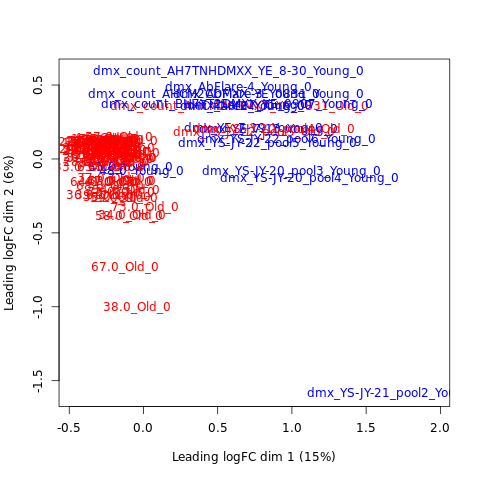

In [102]:
%%R
plotMDS(y, col=ifelse(y$samples$group == "Old", "red", "blue"))

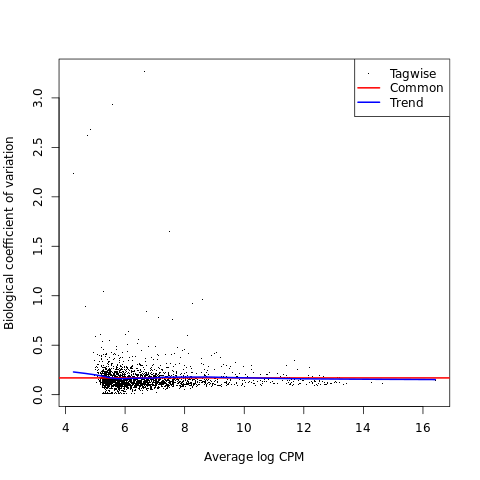

In [103]:
%%R
plotBCV(y)

In [104]:
%%R
colnames(y$design)

[1] "age_groupOld"   "age_groupYoung"


In [105]:
%%R -o tt

myContrast <- makeContrasts(contrasts="age_groupOld-age_groupYoung", levels = y$design)
qlf <- glmQLFTest(fit, contrast=myContrast)

# get all of the DE genes and calculate Benjamini-Hochberg adjusted FDR
tt <- topTags(qlf, n = Inf, adjust.method='fdr', p.value=0.05)
tt <- tt$table

In [106]:
tt.shape

(1166, 5)

In [109]:
tt

,logFC,logCPM,F,PValue,FDR
LST1,-1.888886,5.609596,188.638053,1.826093e-24,5.452713e-21
AIF1,-2.260353,5.266955,179.086736,3.738861e-24,5.582120e-21
LYZ,-2.942184,6.298308,181.636876,7.190821e-24,7.157263e-21
IER3IP1-1,-5.062820,4.268449,138.259675,4.496359e-23,3.356532e-20
NDUFB8-1,-4.959932,5.567253,140.153882,9.020122e-23,5.386817e-20
S100A9,-3.051613,7.134816,162.127468,2.821359e-22,1.404096e-19
S100A8,-3.191340,6.725664,160.613285,3.606124e-22,1.538270e-19
PSMA2-1,-4.994408,4.850015,119.476916,6.072850e-21,2.266691e-18
TMBIM4-1,-4.811625,4.735656,115.457491,1.917290e-20,6.361142e-18
CST3,-1.940397,5.907840,138.861283,2.435463e-20,7.272293e-18


In [112]:
tt = tt.sort_values(by='logFC', ascending=False)
tt.to_csv(os.path.join(output_path, 'pd_dea_raw.csv'))

In [113]:
tt_filt = tt[~ tt.index.str.startswith('RP')]
tt_filt.to_csv(os.path.join(output_path, 'pd_dea_non_rb_all.csv'))
tt_filt[tt_filt.logFC > 0.5].to_csv(os.path.join(output_path, 'pd_dea_non_rb_up.csv'))
tt_filt[tt_filt.logFC < -0.5].to_csv(os.path.join(output_path, 'pd_dea_non_rb_down.csv'))

In [114]:
with open(os.path.join(output_path, 'up_genes.txt'), 'w') as f:
    for gene in tt_filt[tt_filt.logFC > 0.5].index.tolist():
        f.write(f'{gene}\n')

with open(os.path.join(output_path, 'down_genes.txt'), 'w') as f:
    for gene in tt_filt[tt_filt.logFC < -0.5].index.tolist():
        f.write(f'{gene}\n')

In [115]:
tt['name'] = tt.index.tolist()

### Functional analysis

In [122]:
tt = pd.read_csv(os.path.join(output_path, 'pd_dea_non_rb_all.csv'))
tt.index = tt['Unnamed: 0']
tt = tt.drop(columns=['Unnamed: 0'])

In [124]:
%%R -i tt

# prepare input

original_gene_list <- tt$logFC
names(original_gene_list) <- rownames(tt)

# omit any NA values (if nesessary) 
gene_list <- na.omit(original_gene_list)

# # sort the list in decreasing order (required for clusterProfiler)
gene_list <- sort(gene_list, decreasing = TRUE)

In [143]:
%%R

gse <- gseGO(geneList=gene_list, 
             ont ="ALL", 
             keyType = "ALIAS", 
             minGSSize = 3, 
             maxGSSize = 800, 
             pvalueCutoff = 0.05, 
             verbose = TRUE, 
             OrgDb = "org.Hs.eg.db", 
             pAdjustMethod = "none")
gse <- pairwise_termsim(gse)

gse_simplified <- simplify(gse, cutoff = 0.7, by = "p.adjust", select_fun = min)

Exception ignored from cffi callback <function _processevents at 0x7f2cc58c4360>:
Traceback (most recent call last):
  File "/opt/conda/envs/scenv/lib/python3.11/site-packages/rpy2/rinterface_lib/callbacks.py", line 275, in _processevents
    @ffi_proxy.callback(ffi_proxy._processevents_def,
    
KeyboardInterrupt: 
Exception ignored from cffi callback <function _processevents at 0x7f2cc58c4360>:
Traceback (most recent call last):
  File "/opt/conda/envs/scenv/lib/python3.11/site-packages/rpy2/rinterface_lib/callbacks.py", line 275, in _processevents
    @ffi_proxy.callback(ffi_proxy._processevents_def,
    
KeyboardInterrupt: 
Exception ignored from cffi callback <function _processevents at 0x7f2cc58c4360>:
Traceback (most recent call last):
  File "/opt/conda/envs/scenv/lib/python3.11/site-packages/rpy2/rinterface_lib/callbacks.py", line 275, in _processevents
    @ffi_proxy.callback(ffi_proxy._processevents_def,
    
KeyboardInterrupt: 
Exception ignored from cffi callback <function

using 'fgsea' for GSEA analysis, please cite Korotkevich et al (2019).

preparing geneSet collections...
GSEA analysis...
Error in match.arg(method) : 
  'arg' should be one of “holm”, “hochberg”, “hommel”, “bonferroni”, “BH”, “BY”, “fdr”, “none”


RInterpreterError: Failed to parse and evaluate line '\ngse <- gseGO(geneList=gene_list, \n             ont ="ALL", \n             keyType = "ALIAS", \n             minGSSize = 3, \n             maxGSSize = 800, \n             pvalueCutoff = 0.05, \n             verbose = TRUE, \n             OrgDb = "org.Hs.eg.db", \n             pAdjustMethod = "none")\ngse <- pairwise_termsim(gse)\n\ngse_simplified <- simplify(gse, cutoff = 0.7, by = "p.adjust", select_fun = min)\n'.
R error message: "Error in match.arg(method) : \n  'arg' should be one of “holm”, “hochberg”, “hommel”, “bonferroni”, “BH”, “BY”, “fdr”, “none”"
R stdout:
using 'fgsea' for GSEA analysis, please cite Korotkevich et al (2019).

preparing geneSet collections...
GSEA analysis...

In [130]:
%%R

gse

#
# Gene Set Enrichment Analysis
#
#...@organism 	 Homo sapiens 
#...@setType 	 GOALL 
#...@keytype 	 ALIAS 
#...@geneList 	 Named num [1:1110] 5.46 4.56 4.07 4.06 3.91 ...
 - attr(*, "names")= chr [1:1110] "DONSON" "TMBIM4.1" "PSMA2.1" "TAP2.1" ...
#...nPerm 	 
#...pvalues adjusted by 'BH' with cutoff <0.05 
#...1 enriched terms found
'data.frame':	1 obs. of  12 variables:
 $ ONTOLOGY       : chr "BP"
 $ ID             : chr "GO:0016070"
 $ Description    : chr "RNA metabolic process"
 $ setSize        : int 365
 $ enrichmentScore: num -0.295
 $ NES            : num -1.87
 $ pvalue         : num 9.11e-06
 $ p.adjust       : num 0.0437
 $ qvalue         : num 0.0436
 $ rank           : num 547
 $ leading_edge   : chr "tags=65%, list=49%, signal=49%"
 $ core_enrichment: chr "RSL1D1/RBM8A/PTMA/TPR/SNRPB2/TRA2B/ZMAT2/CSDE1/SMARCE1/N4BP2L2/HMGB1/SP100/HSPA5/SNW1/CEBPB/PARP1/PRPF6/CWF19L2"| __truncated__
#...Citation
 T Wu, E Hu, S Xu, M Chen, P Guo, Z Dai, T Feng, L Zhou, W Tang, L Zhan, X

In [128]:
%%R

gene_list

       DONSON      TMBIM4.1       PSMA2.1        TAP2.1      NDUFB8.1 
    5.4586672     4.5593902     4.0655354     4.0604700     3.9132583 
    IER3IP1.1      UQCR11.1           TNF          CCL3      HLA-DQA2 
    3.9118064     3.6515283     1.6813898     1.4290615     1.2964757 
       COL6A2       CTDNEP1         PTGDS       TMEM259         PTGDR 
    1.2425123     1.0840985     1.0474987     1.0200827     0.9302810 
        FMNL1         TGFB1        TMBIM1        THAP11        GTPBP6 
    0.9270915     0.9261786     0.9190074     0.8773975     0.8455019 
       FAM89B       ABHD17A         SIPA1       PLEKHF1        ACTR1B 
    0.8373063     0.8369127     0.8340864     0.8275369     0.8227806 
      TMEM203    ST6GALNAC6          PIM1         SF3A2         GPR56 
    0.8225494     0.8109980     0.8084219     0.7988033     0.7923936 
        S1PR4       ABHD14B        PTPN18       TMEM165       PSTPIP1 
    0.7809829     0.7734204     0.7728214     0.7726709     0.7624748 
      

In [131]:
%%R 
gse_df <- as.data.frame(gse)
write.csv(gse_df, file = "ages_gsea_results.csv", row.names = TRUE)

In [ ]:
# save R plots:

# png("signs_gsea_dotplot.png", width = 1400, height = 800, res = 100)
# ...
# dev.off

In [ ]:
%%R -w 800 -h 500

require(DOSE)

dotplot(gse_simplified, showCategory=10, split=".sign") + 
    facet_grid(.~.sign) +
    theme(axis.text.y = element_text(size = 12, vjust=0.5), strip.text = element_text(size = 14)) +
    scale_y_discrete(labels = scales::label_wrap(40))

In [27]:
%%R 

png("output_raw/signs_gsea_dotplot.png", width = 800, height = 500, res = 300)
# dotplot(gse_simplified, showCategory=10, split=".sign") + 
#     facet_grid(.~.sign) +
#     theme(axis.text.y = element_text(size = 12, vjust=0.5), strip.text = element_text(size = 14)) 
#     scale_y_discrete(labels = scales::label_wrap(40))
dev.off()

png 
  2 


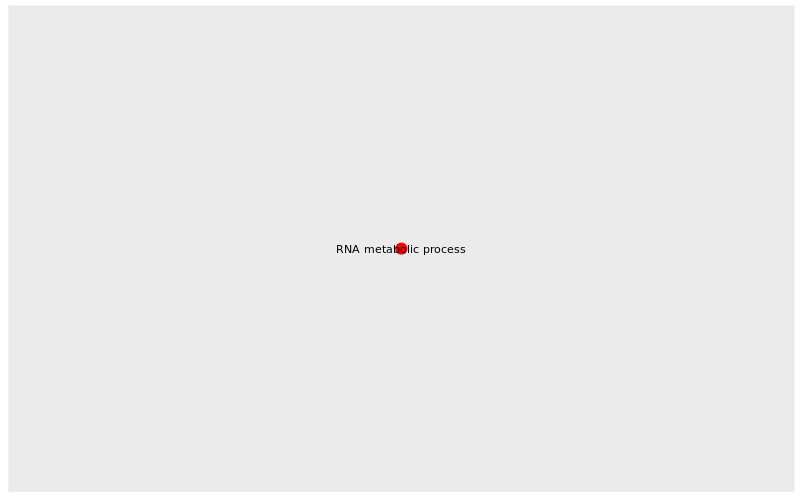

In [133]:
%%R -w 800 -h 500

emapplot(gse, showCategory = 10)

In [156]:
pb_up = pd.read_csv(os.path.join(output_path, 'pd_dea_non_rb_up.csv'))
pb_down = pd.read_csv(os.path.join(output_path, 'pd_dea_non_rb_down.csv'))

for tt in pb_up, pb_down:
    tt.index = tt['Unnamed: 0']
    tt.drop(columns=['Unnamed: 0'], inplace=True)

In [172]:
with open(os.path.join(output_path, 'pb_down_genes.txt'), 'w') as f:
    for gene in pb_down.index.tolist():
        f.write(f'{gene}\n')

In [173]:
with open(os.path.join(output_path, 'pb_up_genes.txt'), 'w') as f:
    for gene in pb_up.index.tolist():
        f.write(f'{gene}\n')

In [189]:
%%R -i pb_up

genes_up = rownames(pb_up)

up_eGO <- enrichGO(
    gene          = genes_up,
    OrgDb         = org.Hs.eg.db,
    ont           = "BP",
    keyType = "ALIAS",
    pAdjustMethod = "BH",
    pvalueCutoff  = 0.05,
    # readable      = TRUE    
  )

Scale for y is already present.
Adding another scale for y, which will replace the existing scale.


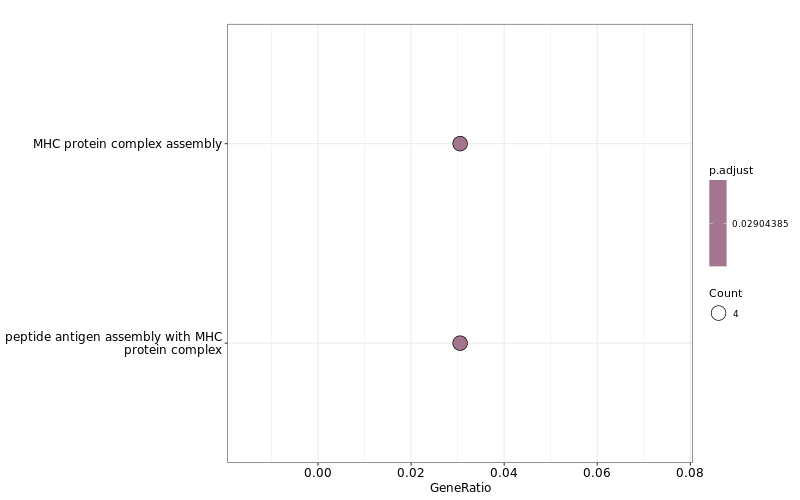

In [164]:
%%R -w 800 -h 500

dotplot(up_eGO, showCategory=10)+ 
    theme(axis.text.y = element_text(size = 12, vjust=0.5), strip.text = element_text(size = 14)) +
    scale_y_discrete(labels = scales::label_wrap(40))

In [167]:
%%R -i pb_down

genes_down = rownames(pb_down)

down_eGO <- enrichGO(
    gene          = genes_down,
    OrgDb         = org.Hs.eg.db,
    ont           = "BP",
    keyType = "ALIAS",
    pAdjustMethod = "BH",
    pvalueCutoff  = 0.05,
    # readable      = TRUE    
  )

Error in ans[ypos] <- rep(yes, length.out = len)[ypos] : 
  replacement has length zero
In addition: Warning message:
In rep(yes, length.out = len) : 'x' is NULL so the result will be NULL


In [207]:
%%R -i pb_up

up_genes <- rownames(pb_up)

gost_res <- gost(up_genes, organism = "hsapiens", 
                 sources=c("GO:BP", "GO:MF"), ordered_query=TRUE,
                 significant = TRUE, user_threshold = 0.05,
                 correction_method = "fdr"
                )

# Convert the results to a df
gost_df <- gost_res$result

# Convert any list columns to character
gost_df[] <- lapply(gost_df, function(x) {
  if (is.list(x)) {
    sapply(x, toString)
  } else {
    x
  }
})

write.csv(gost_df, file = "pb_up_gost_results.csv", row.names = FALSE)

In [228]:
gost_df.head()

,query,significant,p_value,term_size,query_size,intersection_size,precision,recall,term_id,source,term_name,effective_domain_size,source_order,parents
0,query_1,True,0.000260,6250,126,66,0.523810,0.010560,GO:0048518,GO:BP,positive regulation of biological process,21031,13226,"GO:0008150, GO:0050789"
1,query_1,True,0.000794,15,3,2,0.666667,0.133333,GO:0150078,GO:BP,positive regulation of neuroinflammatory response,21031,20656,"GO:0050729, GO:0150076, GO:0150077"
2,query_1,True,0.000794,3711,124,44,0.354839,0.011857,GO:0009893,GO:BP,positive regulation of metabolic process,21031,3791,"GO:0008152, GO:0019222, GO:0048518"
3,query_1,True,0.000794,946,58,13,0.224138,0.013742,GO:0045321,GO:BP,leukocyte activation,21031,11749,"GO:0001775, GO:0002376"
4,query_1,True,0.000794,12287,53,47,0.886792,0.003825,GO:0050789,GO:BP,regulation of biological process,21031,13687,"GO:0008150, GO:0065007"


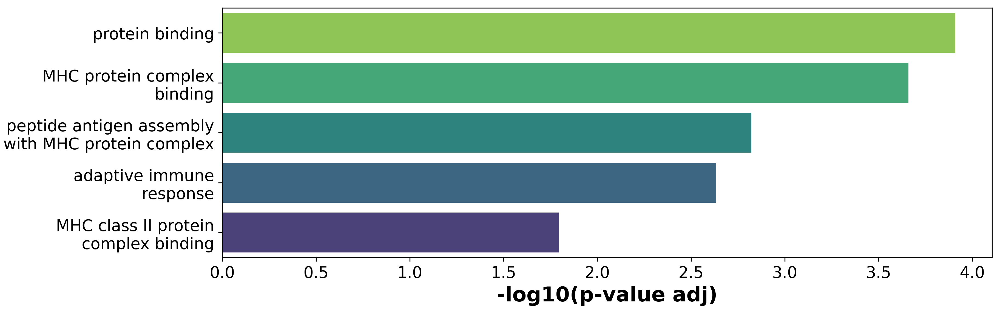

In [330]:
gost_df = pd.read_csv("pb_up_gost_results.csv")

significant_results = gost_df[gost_df['p_value'] < 0.05]
significant_results['-log10p'] = -(np.log10(significant_results['p_value']))

terms_list = ['protein binding', 'MHC protein complex binding', 'MHC class II protein complex binding', 
              'peptide antigen assembly with MHC protein complex', 'adaptive immune response'] 
top_terms = significant_results[significant_results.term_name.isin(terms_list)]
top_terms = top_terms.sort_values('p_value', ascending=False).head(10)

plt.figure(figsize=(12, 4))
sns.barplot(data=top_terms, x='-log10p', y='term_name', palette='viridis')
plt.xlabel('-log10(p-value adj)', fontweight='bold', fontsize=18)
plt.ylabel('GO Terms\n',
           fontsize=18, fontweight='bold'
           # rotation='horizontal', 
           # ha='center', position = (0.5, 1)
          )
plt.yticks(fontsize=14, wrap=True)

# plt.title('Top GO Terms by P-value')
plt.gca().invert_yaxis()
plt.show()

In [278]:
%%R -i pb_down

down_genes <- rownames(pb_down)

down_gost_res <- gost(down_genes, organism = "hsapiens", 
                 sources=c("GO:BP", "GO:MF"), ordered_query=TRUE,
                 significant = TRUE, user_threshold = 0.05,
                 correction_method = "fdr"
                )

# Convert the results to a df
down_gost_df <- down_gost_res$result

# Convert any list columns to character
down_gost_df[] <- lapply(down_gost_df, function(x) {
  if (is.list(x)) {
    sapply(x, toString)
  } else {
    x
  }
})

write.csv(down_gost_df, file = "pb_down_gost_results.csv", row.names = FALSE)

In [331]:
down_gost_df = pd.read_csv("pb_down_gost_results.csv")

significant_results = down_gost_df[down_gost_df['p_value'] < 0.05]
significant_results['-log10p'] = -(np.log10(significant_results['p_value']))

terms_list_bp = ['innate immune response', 'regulation of defense response', 
                 'positive regulation of immune system process', 'RNA biosynthetic process', 'activation of immune response', 
                 'nucleobase-containing compound biosynthetic process', 'protein-DNA complex organization', 
                 'chromatin organization', 'regulation of gene expression', 'regulation of response to stimulus',  
                 'intracellular transport', 'immune response-activating signaling pathway', 
                 'T cell activation', 'T cell differentiation', 'positive regulation of innate immune response', 
                 'positive regulation of RNA metabolic process', 'positive regulation of immune response', 
                 'regulation of DNA-templated transcription', 'positive regulation of nucleobase-containing compound metabolic process', 
                 'activation of innate immune response', 'positive regulation of immune system process', 'protein-DNA complex organization']

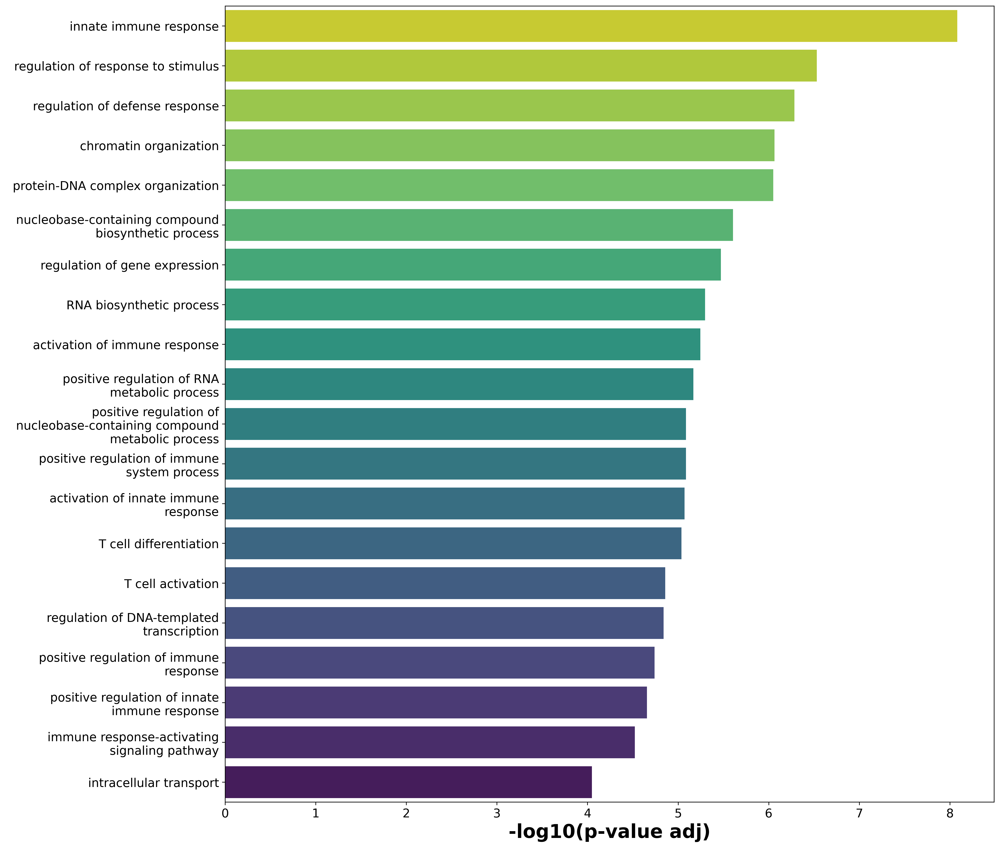

In [332]:
# GO BP
top_terms = significant_results[significant_results.term_name.isin(terms_list_bp)]
top_terms = top_terms.sort_values('-log10p')

plt.figure(figsize=(16, 17))
sns.barplot(data=top_terms, x='-log10p', y='term_name', palette='viridis')
plt.xlabel('-log10(p-value adj)', fontsize=22, fontweight='bold')
plt.ylabel('GO Terms\n',
           fontsize=22, fontweight='semibold', 
           # rotation='horizontal', 
           # ha='center', position = (0.5, 1)
          )
plt.yticks(fontsize=14, wrap=True)

# plt.title('Top GO Terms by P-value')
plt.gca().invert_yaxis()
plt.show()